# **Heston Model Project**
Anita Mezzetti 

course: Machine Learning for finance

Table of context:
- [Explicit solution of the Heston price equation (functions)](#solution)
- [Stock paths generator (functions)](#stock)
- [Generate data](#data)
- [Monte Carlo simulation](#mc)
    - [Monte Carlo simulation with Antithetic variables](#mcav)
    - [Time analysis of Monte Cralo](#time_mc)
    - [Effects in changing number of simulations in Monte Carlo](#sim_mc)
    - [Error analysis Monte Carlo](#error_mc)
- [ML methods](#ml)
    - [Motivation in combining regression and classification](#moti)
    - [Classification](#classification)
    - [Regression](#regression)
- [ATM area](#atm)
- [Add other features](#other_variables)
- [S0 fixed and K moves](#k)


### Import packages

In [2]:
import numpy as np
import pandas as pd
import math as math
import cmath as cmath
from scipy.stats import norm
from scipy import integrate
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
import tensorflow as tf
import time
from xgboost import XGBClassifier
import warnings
from sklearn.exceptions import DataConversionWarning
from pandas.core.common import SettingWithCopyWarning
warnings.filterwarnings(action='ignore', category=DataConversionWarning)
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

# Explicit solution of the Heston price equation <a class="anchor" id="solution"></a>
In this section, we define the functions needed to find the numberical solution:
$$ C(S,T) = S P_1 - K P_2 $$
More details in the report

In [83]:
# characteristic function
def f(phi, kappa, theta, sigma, rho, v0, r, T, s0, status):
    
    a = kappa * theta
    x = math.log(s0)
    
    # remind that lamda is zero
    if status == 1:
        u = 0.5
        b = kappa - rho * sigma
    else:
        u = -0.5
        b = kappa
    
    d = cmath.sqrt((rho * sigma * phi * 1j - b)**2 - sigma**2 * (2 * u * phi * 1j - phi**2))
    g = (b - rho * sigma * phi * 1j + d) / (b - rho * sigma * phi * 1j - d)
    
    C = r * phi * 1j * T + (a / sigma**2)*((b - rho * sigma * phi * 1j + d) * T - 2 * cmath.log((1 - g * cmath.exp(d * T))/(1 - g)))
    D = (b - rho * sigma * phi * 1j + d) / (sigma**2) * ((1 - cmath.exp(d * T)) / (1 - g * cmath.exp(d * T)))
    
    return cmath.exp(C + D * v0 + 1j * phi * x)

In [84]:
# P1 and P2
def p(kappa, theta, sigma, rho, v0 ,r ,T ,s0 , K, status):
    
    
    integrand = lambda phi: (cmath.exp(-1j * phi * cmath.log(K)) * f(phi, kappa, \
                              theta, sigma, rho, v0, r, T, s0, status) / (1j * phi)).real 
    
    return (0.5 + (1 / math.pi) * integrate.quad(integrand, 0, 100)[0]) # approximate indefinite intergral with a definite one

def p1(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K):
    return p(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K, 1)

def p2(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K):
    return p(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K, 2)


In [85]:
# call price
def call_price(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K):
    
    P1 = p1(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K)
    P2 = p2(kappa, theta, sigma, rho, v0 ,r ,T ,s0 ,K)
    
    result = (s0 * P1 - K * math.exp(-r * T) * P2)
    
    if result<0 or k-s0>1: # negative result or initial price very very low with respect to k
        result = 0
        
    return result

# Stock paths generator <a class="anchor" id="stock"></a>
We define the functions needed to create the stock paths using the Heston model dynamic:


In [86]:
# generate the stock price simulation
def stock_price_generator (T, n , m, r, S0, k, V0, sigma, theta, kappa, rho, generator, entire_stock=False ):
    dt = T / n
    
    # Brownian motions:
    dw_v = generator.normal(size=(m, n)) * np.sqrt(dt)
    dw_i = generator.normal(size=(m, n)) * np.sqrt(dt)

    dw_s = rho * dw_v + np.sqrt(1.0 - rho ** 2) * dw_i

    # Perform time evolution 
    s = np.empty((m, n + 1)) # initialisation stock prices vector
    s[:, 0] = S0

    v = np.ones(m) * V0

    for t in range(n):
        dv = kappa * (theta - v) * dt + sigma * np.sqrt(v) * dw_v[:, t]
        ds = r * s[:, t] * dt + np.sqrt(v) * s[:, t] * dw_s[:, t]

        v = np.clip(v + dv, a_min=0.0, a_max=None)
        s[:, t + 1] = s[:, t] + ds
        
    if entire_stock==False: # return only the stocks simulation at T
        result = s[:,-1]; 
    else:
        result = s; # return all the stock dynamic
        
    return result
    

In [87]:
# find the stock price from ST as expected return
def find_expected_payoff(stock_path, k, r, t_max):
    payoff = max(stock_path[-1] - k, 0) # one payoff for each simulation
    c = payoff * np.exp(-r * t_max)     # in case r=0, this step is useless
    
    return c

# Generate Data <a class="anchor" id="data"></a>

- [all values fixed apart S0](#data1)
- [all values fixed apart K](#data2)
- [all values fixed apart S0 and r](#data3)
- [all values fixed apart S0 and V0](#data4)
- [all values fixed apart S0, T and V0](#data5)

In [88]:
generator = np.random.default_rng()

**- All values fixed apart S0**

In [5]:
# set parameters and constants
r = 0
k = 2
V0 = 0.01
sigma = 0.6
theta = 0.02
kappa = 6.21
T1 = 10
rho = -0.5

S0 = np.arange(0.5,4,0.01)

In [3]:
time_maturity = 3
num_simulations = 100
n = 250 # numbers of division of the time 

In [2]:
#df1 = pd.read_csv('datasets/df1.csv')
#df1 = df1.drop('Unnamed: 0', axis=1)

df1 = pd.DataFrame(columns=['stock_zero', 'price'])

In [ ]:
# fill the dataset
for s0 in S0:
    s = stock_price_generator (time_maturity, n, num_simulations, r, s0, k, V0, sigma, theta, kappa, rho, generator, entire_stock=True)

    for stock_path in s: # for each simulation
        price = find_expected_payoff(stock_path, k, r, time_maturity)
        
        new_row = {
                      'price':price, 
                      'stock_zero':stock_path[T1],
                  }
        #append row to the dataframe
        df1 = df1.append(new_row, ignore_index=True)

In [93]:
df1.head()

,stock_zero,price
0,0.524303,0.0
1,0.522428,0.0
2,0.499181,0.0
3,0.494353,0.0
4,0.502161,0.0


In [94]:
len(df1)

70000

In [95]:
#df1.to_csv('datasets/df1.csv')

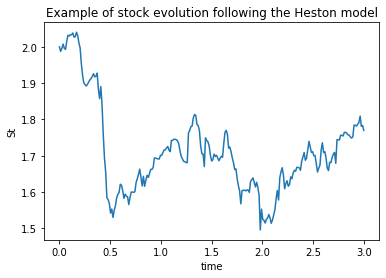

In [187]:
# plot one possible stock evolution as example example
stock_evolution = stock_price_generator (time_maturity, n, 1, r, 2, k, V0, sigma, theta, kappa, rho, generator, entire_stock=True)
stock_evolution = stock_evolution[0]
#plt.plot(stock_evolution)
x = np.linspace(0, time_maturity, num=n+1)

plt.plot(x, stock_evolution)
plt.title("Example of stock evolution following the Heston model")
plt.xlabel("time")
plt.ylabel("St")
#plt.savefig('plots/stock_evolution.pdf')
plt.show()

# Monte Carlo simulation  <a class="anchor" id="mc"></a>

In [97]:
# function which finds the expected payoff 
def find_mc_price(sT, k, r, T):
    final = sT - k
    payoff = [max(x,0) for x in final] # one payoff for each simulation
    payoff = np.asarray(payoff)
    
    expected_payoff = payoff.mean() # mean
    
    c = expected_payoff * np.exp(-r * T)     # in case r=0, this step is useless
    
    return c

In [98]:
num_sim_mc = 1000

**- All values fixed apart S0**

In [99]:
df1_mc = pd.DataFrame(columns=['stock_zero', 'mc_price', 'num_price'])

In [4]:
#df1_mc = pd.read_csv('datasets/df1_mc.csv')
#df1_mc = df1_mc.drop('Unnamed: 0', axis=1)

In [ ]:
# find the mc price
for s0 in S0:
    sT = stock_price_generator (time_maturity, n, num_sim_mc, r, s0, k, V0, sigma, theta, kappa, rho, generator)

    mc = find_mc_price(sT, k, r, time_maturity)
    
    num_price = call_price(kappa, theta, sigma, rho, V0, r, time_maturity, s0, k)

    new_row = {
                  'mc_price':mc, 
                  'stock_zero':s0,
                  'num_price': num_price,
              }
    #append row to the dataframe
    df1_mc = df1_mc.append(new_row, ignore_index=True)

In [102]:
df1_mc.head()

,stock_zero,mc_price,num_price,mc_price_av
0,0.50,0.0,0.0,0.0
1,0.51,0.0,0.0,0.0
2,0.52,0.0,0.0,0.0
3,0.53,0.0,0.0,0.0
4,0.54,0.0,0.0,0.0


In [103]:
len(df1_mc)

350

#### Plot MC simulations only to give a graphical idea

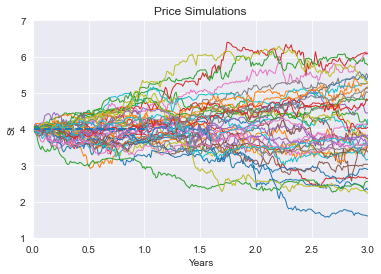

In [328]:
s_entire = stock_price_generator (time_maturity, n, 1000, r, s0, k, V0, sigma, theta, kappa, rho, generator, entire_stock=True)
expected_price = s_entire[:, -1].mean()

# plot plt.figure(figsize=(8,6))
# noinspection PyTypeChecker
ax_lines = plt.axes()

# Make the line plots
t = np.linspace(0, time_maturity, num=n + 1)
ns = 40
for i in range(ns):
    ax_lines.plot(t, s_entire[i, :], lw=1.0)
ax_lines.set(xlabel='Years', ylabel='St',title='Price Simulations')
ax_lines.set_xlim((0, time_maturity))
ax_lines.set_ylim((1, 7))

# Add mean value to line plots
ax_lines.plot([0.0, 1.0], [expected_price, expected_price], lw='2', ls="--", label='mean')
#plt.savefig('plots/mc_simualtion.pdf')
plt.show()

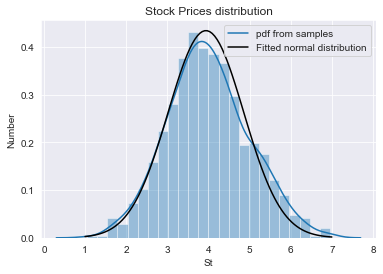

In [330]:
sns.set_style('darkgrid')
sns.distplot(s_entire[:, -1])
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k')
plt.xlabel('St')
plt.ylabel('Number')
plt.title('Stock Prices distribution')
plt.legend(["pdf from samples", "Fitted normal distribution"])
#plt.savefig('plots/normal_distribution.pdf')
plt.show()

## Monte Carlo simulation with Antithetic variables <a class="anchor" id="mcav"></a>

In [104]:
def stock_price_generator_av (T, n ,m, r, S0, k, V0, sigma, theta, kappa, rho, separate=False):
    dt = T / n
    
    m = int(m/2) # with av we can do half of the simulations
    n = int(n)
    
    # Brownian motions:
    dw_v = generator.normal(size=(m, n)) * np.sqrt(dt)
    dw_i = generator.normal(size=(m, n)) * np.sqrt(dt)

    dw_s = rho * dw_v + np.sqrt(1.0 - rho ** 2) * dw_i

    # Perform time evolution 
    s = np.empty((m, n + 1)) # initialisation stock prices vector
    s[:, 0] = S0
    
    s_ant = np.empty((m, n + 1))
    s_ant[:, 0] = S0

    v = np.ones(m) * V0
    v_ant = np.ones(m) * V0

    for t in range(n):
        dv = kappa * (theta - v) * dt + sigma * np.sqrt(v) * dw_v[:, t]
        dv_ant = kappa * (theta - v_ant) * dt + sigma * np.sqrt(v_ant) * dw_v[:, t]
        ds = r * s[:, t] * dt + np.sqrt(v) * s[:, t] * dw_s[:, t]
        ds_ant = r * s_ant[:, t] * dt + np.sqrt(v_ant) * s_ant[:, t] * dw_s[:, t]

        v = np.clip(v + dv, a_min=0.0, a_max=None)
        v_ant = np.clip(v_ant + dv_ant, a_min=0.0, a_max=None)
        
        s[:, t + 1] = s[:, t] + ds
        s_ant[:, t + 1] = s_ant[:, t] + ds_ant
        
    if separate==True:
        return s, s_ant
        
    return np.concatenate((s, s_ant))[:,-1]

In [105]:
mc_price_av = []

In [ ]:
# find the mc price
for s0 in S0:
    ST_ant = stock_price_generator_av (time_maturity, n, num_sim_mc, r, s0, k, V0, sigma, theta, kappa, rho, generator)
    mc_av = find_mc_price(ST_ant, k, r, time_maturity)
    
    mc_price_av.append(mc_av)

In [107]:
#df1_mc['mc_price_av'] = mc_price_av

In [108]:
df1_mc.head()

,stock_zero,mc_price,num_price,mc_price_av
0,0.50,0.0,0.0,0.0
1,0.51,0.0,0.0,0.0
2,0.52,0.0,0.0,0.0
3,0.53,0.0,0.0,0.0
4,0.54,0.0,0.0,0.0


In [109]:
# df1_mc.to_csv('datasets/df1_mc.csv')

In [110]:
df1_mc = pd.read_csv('datasets/df1_mc.csv')
df1_mc = df1_mc.drop('Unnamed: 0', axis=1)
df1_mc.head()

,stock_zero,mc_price,num_price,mc_price_av
0,0.50,0.0,0.0,0.0
1,0.51,0.0,0.0,0.0
2,0.52,0.0,0.0,0.0
3,0.53,0.0,0.0,0.0
4,0.54,0.0,0.0,0.0


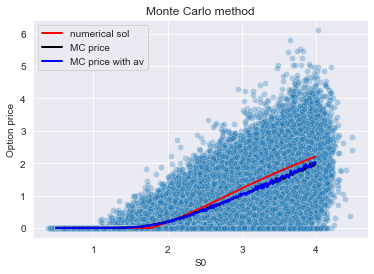

In [333]:
sns.scatterplot(data=df1, x="stock_zero", y="price", alpha =0.3)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='numerical sol')
plt.plot(S0, df1_mc.mc_price, color='black', linewidth=2, label='MC price')
plt.plot(S0, df1_mc.mc_price_av, color='blue', linewidth=2, label='MC price with av')
plt.legend()
plt.xlabel('S0')
plt.ylabel('Option price')
plt.title("Monte Carlo method")
#plt.savefig('plots/mc_normal_av.pdf')
plt.show()

The result with mc and mc_av are quite similar. let us know the difference in terms standard deviation and time needed to compute them 

In [351]:
# show lower volatility for av:
s_ant = stock_price_generator_av (time_maturity, n, num_sim_mc, r, 1, k, V0, sigma, theta, kappa, rho, generator)
s = stock_price_generator (time_maturity, n, num_sim_mc, r, 2, k, V0, sigma, theta, kappa, rho, generator)
print(f"Standard deviation of ST for MC: {np.std(s)}")
print(f"Standard deviation of ST for MC with AV: {np.std(s_ant)}")

Standard deviation of ST for MC: 0.24515159047808166
Standard deviation of ST for MC with AV: 0.24376037892958272


### Time analysis for Monte Carlo <a class="anchor" id="time_mc"></a>

In [112]:
start = time.time()
for s0 in S0:
    ST_ant = stock_price_generator (time_maturity, n, num_sim_mc, r, s0, k, V0, sigma, theta, kappa, rho, generator)
    mc_av = find_mc_price(ST_ant, k, r, time_maturity)
end = time.time()
time_cm = end - start
print(f"Time needed for Monte Carlo: {time_cm}")

Time needed for Monte Carlo: 23.60903525352478


In [113]:
start = time.time()
for s0 in S0:
    ST_ant = stock_price_generator_av (time_maturity, n, num_sim_mc, r, s0, k, V0, sigma, theta, kappa, rho, generator)
    mc_av = find_mc_price(ST_ant, k, r, time_maturity)
end = time.time()
time_cmav = end - start
print(f"Time needed for Monte Carlo with AV: {time_cmav}")

Time needed for Monte Carlo with AV: 21.19796919822693


In [114]:
perc_faster = (time_cm - time_cmav) / time_cm *100
perc_faster = round(perc_faster,2)
print(f"Monte Carlo with AV is {perc_faster}% faster tham the usual Monte Carlo")

Monte Carlo with AV is 10.21% faster tham the usual Monte Carlo


### Changes with different numbers of simulations <a class="anchor" id="sim_mc"></a>

In [115]:
num_sim_mc1 = 100
num_sim_mc2 = 5000

In [116]:
mc_price_av1 = []

# find the mc price
for s0 in S0:
    ST_ant = stock_price_generator_av (time_maturity, n, num_sim_mc1, r, s0, k, V0, sigma, theta, kappa, rho, generator)
    mc_av = find_mc_price(ST_ant, k, r, time_maturity)
    
    mc_price_av1.append(mc_av)

In [117]:
mc_price_av2 = []

# find the mc price
for s0 in S0:
    ST_ant = stock_price_generator_av (time_maturity, n, num_sim_mc2, r, s0, k, V0, sigma, theta, kappa, rho, generator)
    mc_av = find_mc_price(ST_ant, k, r, time_maturity)
    
    mc_price_av2.append(mc_av)

In [118]:
df1_mc['mc_price_av1'] = mc_price_av1
df1_mc['mc_price_av2'] = mc_price_av2

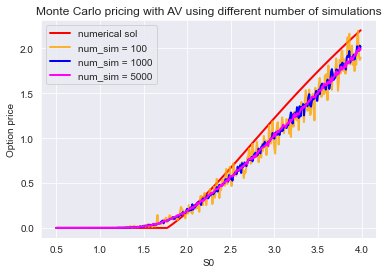

In [332]:
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='numerical sol')
plt.plot(S0, df1_mc. mc_price_av1, color='orange', linewidth=2, label='num_sim = 100', alpha=0.8)
plt.plot(S0, df1_mc. mc_price_av, color='blue', linewidth=2, label='num_sim = 1000')
plt.plot(S0, df1_mc. mc_price_av2, color='magenta', linewidth=2, label='num_sim = 5000')
plt.title("Monte Carlo pricing with AV using different number of simulations")
plt.legend()
plt.xlabel('S0')
plt.ylabel('Option price')
#plt.savefig('plots/mc_different_sim.pdf')
plt.show()

The behaviour is similar for all the numbers of simulations

### Error Analysis MC  <a class="anchor" id="error_mc"></a>

In [121]:
def root_mean_square_error(num_sol, proposed_solution):
    n = len(num_sol) 
    difference = num_sol-proposed_solution
    square_diff = [x ** 2 for x in difference]
    error = np.sqrt((sum(square_diff)/n))
    return error

In [122]:
err_mc = root_mean_square_error(df1_mc.num_price, df1_mc.mc_price)
err_mc_av = root_mean_square_error(df1_mc.num_price, df1_mc.mc_price_av)
err_mc_av1 = root_mean_square_error(df1_mc.num_price, df1_mc.mc_price_av1)
err_mc_av2 = root_mean_square_error(df1_mc.num_price, df1_mc.mc_price_av2)

print(f"RMSQ Monte Carlo (num_simulations = {num_sim_mc}): {err_mc}")
print(f"RMSQ Monte Carlo with AV (num_simulations = {num_sim_mc1}): {err_mc_av1}")
print(f"RMSQ Monte Carlo with AV (num_simulations = {num_sim_mc}): {err_mc_av}")
print(f"RMSQ Monte Carlo with AV (num_simulations = {num_sim_mc2}): {err_mc_av2}")

RMSQ Monte Carlo (num_simulations = 1000): 0.14124623047806095
RMSQ Monte Carlo with AV (num_simulations = 100): 0.15578851031457136
RMSQ Monte Carlo with AV (num_simulations = 1000): 0.1383395065212146
RMSQ Monte Carlo with AV (num_simulations = 5000): 0.1392209677705778


# Machine Learning models <a class="anchor" id="ml"></a>

In [6]:
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import roc_curve
from sklearn.neighbors import KNeighborsClassifier
from xgboost.sklearn import XGBRegressor
from sklearn import metrics
from sklearn.metrics import classification_report

from keras.metrics import BinaryAccuracy, AUC, Precision, Recall
from keras.models import Sequential
from keras.layers import Dense
from keras.callbacks import History
from keras.optimizers import Adam

In [7]:
df1.head()

,stock_zero,price
0,0.524303,0.0
1,0.522428,0.0
2,0.499181,0.0
3,0.494353,0.0
4,0.502161,0.0


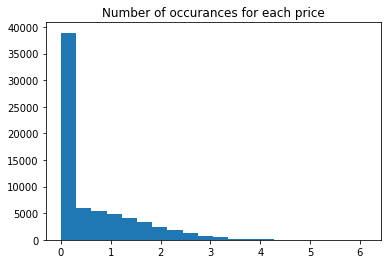

In [190]:
plt.hist(df1.price, bins =20)
plt.title("Number of occurances for each price")
#plt.savefig('plots/occurance_price_all.pdf')
plt.show()

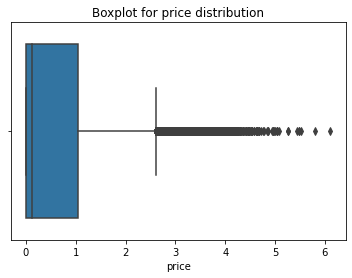

In [191]:
sns.boxplot(x=df1.price)
plt.title("Boxplot for price distribution")
#plt.savefig('plots/volatility_prices.pdf')
plt.show()

### Motivation in combining regression and classification <a class="moti" id="lr"></a>

We start running the simple linear regression, then we add the logistic classification and we plot the differences in order to explain why this combination makes sense. Essentially, this section is an introduction which explain why we decide to combine regression and classification 

In [78]:
y = df1.price
X = df1.stock_zero

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [79]:
x_train = x_train.values.reshape(-1, 1)
y_train = y_train.values.reshape(-1, 1)
x_test = x_test.values.reshape(-1, 1)

In [80]:
lin = LinearRegression()
lin.fit(x_train, y_train)
y_pred_lin = lin.predict(x_test)

print("Linear Regression RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_lin)))

Linear Regression RMSE: 0.5615332819145643


In [81]:
price_linear = lin.predict(S0.reshape(-1, 1))

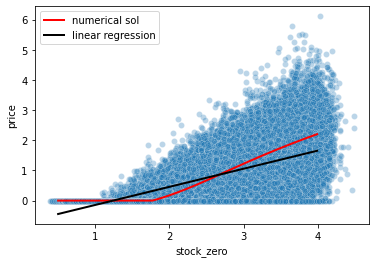

In [192]:
sns.scatterplot(data=df1, x="stock_zero", y="price", alpha =0.3)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='numerical sol')
plt.plot(S0, price_linear, color='black', linewidth=2, label='linear regression')
plt.legend()
#plt.savefig('plots/linear_regression_only.pdf')
plt.show()

In [82]:
df1_class = pd.DataFrame()
df1_class['exercise'] = df1.price!=0
df1_class['stock_zero'] = df1.stock_zero
df1_class.head()

,exercise,stock_zero
0,False,0.524303
1,False,0.522428
2,False,0.499181
3,False,0.494353
4,False,0.502161


In [83]:
X_class = df1_class['stock_zero']
y_class = df1_class['exercise']

x_train_class, x_test_class, y_train_class, y_test_class = train_test_split(X_class, y_class, test_size=0.2)

In [84]:
x_train_class = x_train_class.values.reshape(-1, 1)
y_train_class = y_train_class.values.reshape(-1, 1)
x_test_class = x_test_class.values.reshape(-1, 1)

In [85]:
logreg = LogisticRegression()
logreg.fit(x_train_class, y_train_class)

LogisticRegression()

In [86]:
execute_log = logreg.predict(S0.reshape(-1, 1))

In [87]:
df1_ml = pd.DataFrame()

In [88]:
price_log_lin = []

for i in range(len(S0)):
    if execute_log[i]==0:
        price_log_lin.append(0)
    else:
        price_log_lin.append(price_linear[i])    

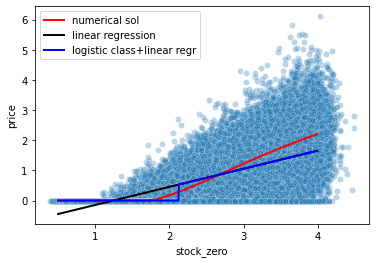

In [89]:
sns.scatterplot(data=df1, x="stock_zero", y="price", alpha =0.3)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='numerical sol')
plt.plot(S0, price_linear, color='black', linewidth=2, label='linear regression')
plt.plot(S0, price_log_lin, color='blue', linewidth=2, label='logistic class+linear regr')
plt.legend()
#plt.savefig('plots/linear_regress_class.pdf')
plt.show()

In [90]:
df1_class['price'] = df1.price

In [91]:
df1_class['exercise_predict'] = logreg.predict(df1_class['stock_zero'].values.reshape(-1, 1))

In [92]:
df1_class.head()

,exercise,stock_zero,price,exercise_predict
0,False,0.524303,0.0,False
1,False,0.522428,0.0,False
2,False,0.499181,0.0,False
3,False,0.494353,0.0,False
4,False,0.502161,0.0,False


In [93]:
# execute linear regression only on nonzero values (only if exercised)
# => liear regression only on cleaned data

df1_class_linear = df1_class.loc[ df1_class['exercise_predict']==True ]
df1_class_linear.head()

,exercise,stock_zero,price,exercise_predict
14188,True,2.124788,0.461163,True
14625,True,2.193899,0.474660,True
14734,False,2.129866,0.000000,True
14825,False,2.133750,0.000000,True
14860,False,2.126172,0.000000,True


In [94]:
y = df1_class_linear.price
X = df1_class_linear.stock_zero

x_train_lin_cleaned, x_test_lin_cleaned, y_train_lin_cleaned, y_test_lin_cleaned = train_test_split(X, y, test_size=0.2)

In [95]:
x_train_lin_cleaned = x_train_lin_cleaned.values.reshape(-1, 1)
y_train_lin_cleaned = y_train_lin_cleaned.values.reshape(-1, 1)
x_test_lin_cleaned = x_test_lin_cleaned.values.reshape(-1, 1)

In [96]:
lin_clean = LinearRegression()
lin_clean.fit(x_train_lin_cleaned, y_train_lin_cleaned)
y_pred_lin_cleaned = lin_clean.predict(x_test_lin_cleaned)

print("Linear Regression RMSE:", np.sqrt(mean_squared_error(y_test_lin_cleaned, y_pred_lin_cleaned)))

Linear Regression RMSE: 0.7056372381920196


In [97]:
price_pred_lin_cleaned = lin_clean.predict(S0.reshape(-1, 1))

In [98]:
df1_ml = pd.DataFrame()

In [99]:
price_log_lin_cleaned = []

for i in range(len(S0)):
    if execute_log[i]==0:
        price_log_lin_cleaned.append(0)
    else:
        price_log_lin_cleaned.append(price_pred_lin_cleaned[i])    

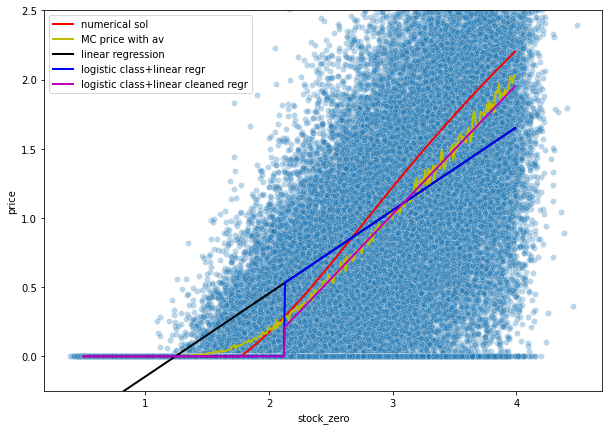

In [133]:
plt.figure(figsize=(10,7))
df1_noout = df1[(np.abs(stats.zscore(df1['price'])) < 3)]
a = sns.scatterplot(data=df1_noout, x="stock_zero", y="price", alpha =0.3)
axes = a.axes
axes.set_ylim(-0.25,2.5)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='numerical sol')
plt.plot(S0, df1_mc. mc_price_av, color='y', linewidth=2, label='MC price with av')
plt.plot(S0, price_linear, color='black', linewidth=2, label='linear regression')
plt.plot(S0, price_log_lin, color='blue', linewidth=2, label='logistic class+linear regr')
plt.plot(S0, price_log_lin_cleaned, color='m', linewidth=2, label='logistic class+linear cleaned regr')
plt.legend()
#plt.savefig('plots/linear_regress_class_mc.pdf')
plt.show()

## Classification methods <a class="anchor" id="classification"></a>

In [200]:
def plot_confusion_matrix (confusion_matrix, title):

    ax = plt.subplot()
    sns.heatmap(confusion_matrix,annot=True,fmt = "d",square = True,ax = ax, linewidths = 1, linecolor = "w", cmap = "Pastel2")
    ax.set_xlabel('True labels')
    ax.set_ylabel('Predicted labels')
    ax.xaxis.set_ticklabels(['Exercised','Not Exercised'])
    ax.yaxis.set_ticklabels(['Exercised','Not Exercised'], va="center")
    plt.title(title)
    fig_directory = 'plots/confusion_matrix_' + title[:5] + '.pdf'
    plt.savefig(fig_directory)
    plt.show()

In [204]:
def plot_roc_curve(X_test, y_test, y_pred, model, title):
    logit_roc_auc = roc_auc_score(y_test, y_pred)
    fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
    plt.figure()
    plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    titlee = 'Exercise ROC curve ' + title
    plt.title(titlee)
    plt.legend(loc="lower right")
    fig_directory = 'plots/roc_curve_' + title[:5] + '.pdf'
    plt.savefig(fig_directory)
    plt.show()

In [4]:
df1_class = pd.DataFrame()
df1_class['exercise'] = df1.price!=0
df1_class['stock_zero'] = df1.stock_zero
df1_class['binary'] = [1 if x==True else 0 for x in df1_class['exercise']]
df1_class.head()

,exercise,stock_zero,binary
0,False,0.524303,0
1,False,0.522428,0
2,False,0.499181,0
3,False,0.494353,0
4,False,0.502161,0


In [115]:
X = df1_class['stock_zero']
y = df1_class['exercise']

X_train, X_test, y_train, y_test, price_train, price_test = train_test_split(X, y, df1['price'], test_size=0.20)

In [116]:
X_train = X_train.values.reshape(-1, 1)
y_train = y_train.values.reshape(-1, 1)
X_test = X_test.values.reshape(-1, 1)

### Logistic Regression

In [117]:
start_log = time.time()
logreg = LogisticRegression()
logreg.fit(X_train, y_train)
end_log = time.time()
end_log-start_log

0.08766770362854004

In [157]:
y_pred_logistic = logreg.predict(X_test)

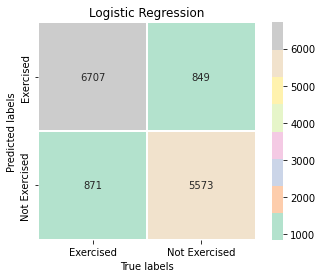

In [202]:
confusion_matrix_logistic = confusion_matrix(y_test, y_pred_logistic, labels=[True, False])
plot_confusion_matrix (confusion_matrix_logistic, 'Logistic Regression')

In [159]:
print(classification_report(y_test, y_pred_logistic))

              precision    recall  f1-score   support

       False       0.87      0.86      0.87      6444
        True       0.89      0.89      0.89      7556

    accuracy                           0.88     14000
   macro avg       0.88      0.88      0.88     14000
weighted avg       0.88      0.88      0.88     14000



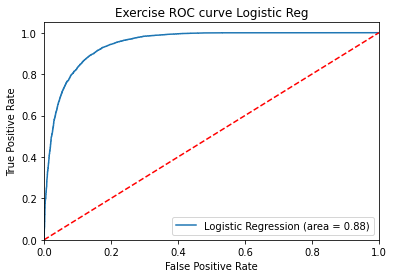

In [205]:
plot_roc_curve(X_test, y_test, y_pred_logistic, logreg, 'Logistic Reg')

### KNN

In [161]:
Neighbor_List=[3,5,10,20]
parameters = {'n_neighbors':Neighbor_List}
KNNC = KNeighborsClassifier()
classifier_knn = GridSearchCV(KNNC, parameters, cv=5, verbose=0, scoring ='accuracy')

classifier_knn.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [3, 5, 10, 20]}, scoring='accuracy')

In [162]:
y_pred_knn = classifier_knn.predict(X_test)

In [163]:
print('Accuracy KNN: {:.2f}%'.format(logreg.score(X_test, y_test)*100))

Accuracy KNN: 87.71%


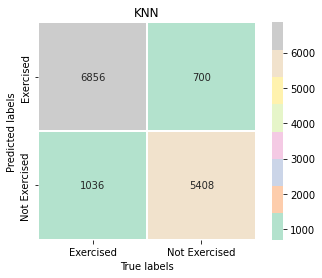

In [206]:
confusion_matrix_knn = confusion_matrix(y_test, y_pred_knn, labels=[True, False])
plot_confusion_matrix (confusion_matrix_knn, 'KNN')

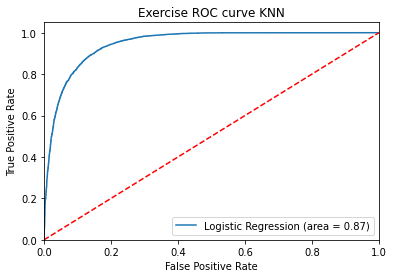

In [207]:
plot_roc_curve(X_test, y_test, y_pred_knn, classifier_knn, 'KNN')

In [166]:
print(classification_report(y_test, y_pred_knn))

              precision    recall  f1-score   support

       False       0.89      0.84      0.86      6444
        True       0.87      0.91      0.89      7556

    accuracy                           0.88     14000
   macro avg       0.88      0.87      0.87     14000
weighted avg       0.88      0.88      0.88     14000



### XGBoost Classifier

In [167]:
params = {
    'n_estimators': [100, 200, 400],
    'max_depth': [2, 3, 6],
    'learning_rate': [0.005, 0.01, 0.02],
    'subsample': [0.4, 0.8]
}

classifier_xgboost = GridSearchCV(XGBClassifier(random_state=10), params, scoring ='accuracy')
classifier_xgboost.fit(X_train, y_train)

GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=10,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=

In [168]:
y_pred_xgboost = classifier_xgboost.predict(X_test)

In [169]:
print(classification_report(y_test, y_pred_xgboost))

              precision    recall  f1-score   support

       False       0.90      0.83      0.86      6444
        True       0.87      0.92      0.89      7556

    accuracy                           0.88     14000
   macro avg       0.88      0.88      0.88     14000
weighted avg       0.88      0.88      0.88     14000



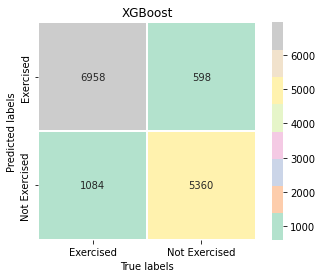

In [208]:
confusion_matrix_knn = confusion_matrix(y_test, y_pred_xgboost, labels=[True, False])
plot_confusion_matrix (confusion_matrix_knn, 'XGBoost')

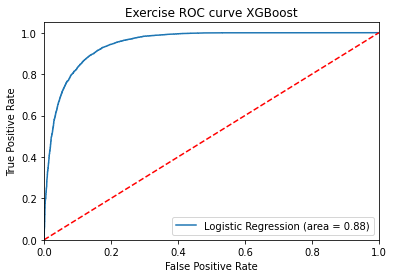

In [209]:
plot_roc_curve(X_test, y_test, y_pred_xgboost, classifier_xgboost, 'XGBoost')

### Neural Network

In [124]:
def print_recall(train_metric, val_metric):
    # summarize history for loss
    plt.plot(train_metric)
    plt.plot(val_metric)
    plt.plot([0, len(train_metric)], [0.5, 0.5], '--', color='black', alpha=0.7)
    plt.title('Model recall progress')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.ylim(ymax = 1, ymin = 0)
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

In [10]:
epoch_num = 30

In [120]:
# 1 hidden layer
start_nn = time.time()
model = Sequential()
model.add(Dense(20, input_dim=1, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer=Adam(),
              loss='binary_crossentropy',
              metrics=[BinaryAccuracy(), AUC(), Precision(), Recall()])

In [121]:
start_nn = time.time()
history = model.fit(X_train, y_train, epochs=epoch_num, validation_data=(X_test, y_test), batch_size=128, callbacks=[History()])
end_nn = time.time()

Epoch 1/30
438/438 [==============================] - 2s 4ms/step - loss: 0.5392 - binary_accuracy: 0.6922 - auc_1: 0.8704 - precision_1: 0.6486 - recall_1: 0.9298 - val_loss: 0.3664 - val_binary_accuracy: 0.8776 - val_auc_1: 0.9465 - val_precision_1: 0.8474 - val_recall_1: 0.9367
Epoch 2/30
438/438 [==============================] - 1s 2ms/step - loss: 0.3083 - binary_accuracy: 0.8776 - auc_1: 0.9464 - precision_1: 0.8765 - recall_1: 0.8983 - val_loss: 0.2984 - val_binary_accuracy: 0.8784 - val_auc_1: 0.9466 - val_precision_1: 0.8702 - val_recall_1: 0.9046
Epoch 3/30
438/438 [==============================] - 1s 2ms/step - loss: 0.2877 - binary_accuracy: 0.8778 - auc_1: 0.9485 - precision_1: 0.8766 - recall_1: 0.8987 - val_loss: 0.2903 - val_binary_accuracy: 0.8801 - val_auc_1: 0.9465 - val_precision_1: 0.8634 - val_recall_1: 0.9180
Epoch 4/30
438/438 [==============================] - 1s 2ms/step - loss: 0.2836 - binary_accuracy: 0.8789 - auc_1: 0.9486 - precision_1: 0.8696 - recall_

In [123]:
end_nn - start_nn

32.66271686553955

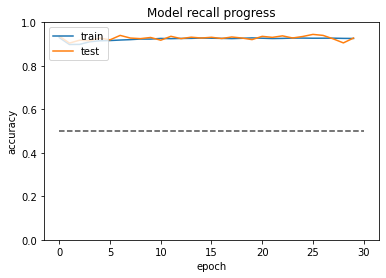

In [126]:
print_recall( history.history['recall_1'], history.history['val_recall_1'])

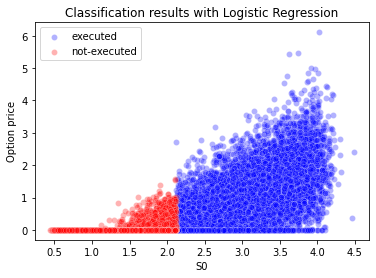

In [134]:
positive_x = X_test[(logreg.predict(X_test)).flatten() > 0.5].flatten()
negative_x = X_test[(logreg.predict(X_test)).flatten() < 0.5].flatten()
positive_y = price_test[(logreg.predict(X_test)).flatten() > 0.5]
negative_y = price_test[(logreg.predict(X_test)).flatten() < 0.5]

sns.scatterplot(x=positive_x, y=positive_y, color='b', alpha =0.3, label="executed")
sns.scatterplot(x=negative_x, y=negative_y, color='r', alpha =0.3, label="not-executed")
plt.title("Classification results with Logistic Regression")
plt.xlabel('S0')
plt.ylabel('Option price')
#plt.savefig('plots/scatter_log.PNG')
plt.show()

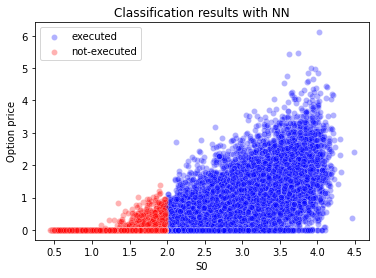

In [135]:
positive_x = X_test[(model.predict(X_test)).flatten() > 0.5].flatten()
negative_x = X_test[(model.predict(X_test)).flatten() < 0.5].flatten()
positive_y = price_test[(model.predict(X_test)).flatten() > 0.5]
negative_y = price_test[(model.predict(X_test)).flatten() < 0.5]

sns.scatterplot(x=positive_x, y=positive_y, color='b', alpha =0.3, label="executed")
sns.scatterplot(x=negative_x, y=negative_y, color='r', alpha =0.3, label="not-executed")
plt.title("Classification results with NN")
plt.xlabel('S0')
plt.ylabel('Option price')
#plt.savefig('plots/scatter_nn.PNG')
plt.show()

As you can see, it OVERFITS => No good method (we leave it only to point out that we have tried but we cannot use a method that overfeats)

### Error Classification

In [200]:
# we get s0 and the numerical solution from the mc dataset
df1_class_s0 = pd.DataFrame()
df1_class_s0 = df1_mc[['stock_zero', 'num_price']]
df1_class_s0['real_exercise'] =  [False if x==0.0 else True for x in df1_class_s0.num_price]
df1_class_s0 = df1_class_s0.drop('num_price', axis=1)

In [201]:
df1_class_s0['log_regre'] = logreg.predict(df1_class_s0['stock_zero'].values.reshape(-1, 1))
df1_class_s0['knn'] = classifier_knn.predict(df1_class_s0['stock_zero'].values.reshape(-1, 1))
df1_class_s0['xg_boost'] = classifier_xgboost.predict(df1_class_s0['stock_zero'].values.reshape(-1, 1))
df1_class_s0.head()

,stock_zero,real_exercise,log_regre,knn,xg_boost
0,0.50,False,False,False,False
1,0.51,False,False,False,False
2,0.52,False,False,False,False
3,0.53,False,False,False,False
4,0.54,False,False,False,False


In [202]:
# from False/True to 0/1 
df1_class_s0 = df1_class_s0.astype(int)
df1_class_s0.head()

,stock_zero,real_exercise,log_regre,knn,xg_boost
0,0,0,0,0,0
1,0,0,0,0,0
2,0,0,0,0,0
3,0,0,0,0,0
4,0,0,0,0,0


In [206]:
error_classification = {}
for column in ['log_regre', 'knn', 'xg_boost']:
    error_classification[column] = root_mean_square_error(df1_class_s0['real_exercise'], df1_class_s0[column])

In [208]:
error_classification

{'log_regre': 0.31622776601683794,
 'knn': 0.27255405754769874,
 'xg_boost': 0.2449489742783178}

## Regression methods <a class="anchor" id="regression"></a>

First create the dataset for the regression and prepare data

In [101]:
df1['pred_executed_logistic'] = logreg.predict(df1['stock_zero'].values.reshape(-1, 1))
df1.head()

,stock_zero,price,pred_executed_logistic
0,0.524303,0.0,False
1,0.522428,0.0,False
2,0.499181,0.0,False
3,0.494353,0.0,False
4,0.502161,0.0,False


In [102]:
df1_regr = df1[df1['pred_executed_logistic']==True]
df1_regr = df1_regr.drop('pred_executed_logistic', axis=1)
df1_regr.head()

,stock_zero,price
14188,2.124788,0.461163
14625,2.193899,0.474660
14706,2.119692,0.256519
14734,2.129866,0.000000
14825,2.133750,0.000000


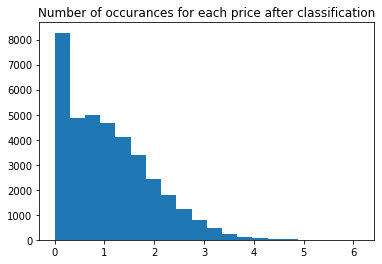

In [70]:
plt.hist(df1_regr.price, bins =20)
plt.title("Number of occurances for each price after classification")
#plt.savefig('plots/occurance_price_postclass.pdf')
plt.show()

In [103]:
X = df1_regr['stock_zero']
y = df1_regr['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

In [78]:
X_train = X_train.values.reshape(-1, 1)
y_train = y_train.values.reshape(-1, 1)
X_test = X_test.values.reshape(-1, 1)

### Linear Regression

In [17]:
lin = LinearRegression()
lin.fit(X_train, y_train)
y_pred_lin = lin.predict(X_test)

### Ridge Regression

In [18]:
parameters = {'alpha': np.arange(0.001, 0.01, 0.1)}
ridge = Ridge()
ridge_best = GridSearchCV(ridge, parameters, scoring ='neg_mean_squared_error')
ridge_best.fit(X_train, y_train)
y_pred_ridge = ridge_best.predict(X_test)

### Decision Tree

In [19]:
DTSplitList=[0.001,0.05,0.1, 0.99]
DTLeafList=[0.005, 0.1,0.5]
criterion =['mse']
max_depth = list(range(30,0,-2))
parameters = {'criterion':criterion,'max_depth':max_depth, 'min_samples_leaf': DTLeafList, 'min_samples_split':DTSplitList}
DTR = DecisionTreeRegressor(random_state=10)
dec_tree = GridSearchCV(DTR, parameters, scoring ='neg_mean_squared_error')

dec_tree.fit(X_train, y_train)
y_pred_dec = dec_tree.predict(X_test)

In [20]:
print("DTR best parameters:", dec_tree.best_params_)

DTR best parameters: {'criterion': 'mse', 'max_depth': 30, 'min_samples_leaf': 0.005, 'min_samples_split': 0.1}


### Random Forest

In [21]:
RFEstimatorList = [25,50,100,200]
criterion =['mse']
max_depth = list(range(20,0,-2))

parameters = {'criterion':criterion,'max_depth':max_depth,'n_estimators':RFEstimatorList}

RFR = RandomForestRegressor(random_state=10)
RFR_best = GridSearchCV(RFR, parameters, cv=5, verbose=0,scoring ='neg_mean_squared_error')
RFR_best.fit(X_train, y_train)

y_pred_random = RFR_best.predict(X_test)

In [224]:
print("RFR best parameters:", RFR_best.best_params_)

RFR best parameters: {'criterion': 'mse', 'max_depth': 4, 'n_estimators': 200}


### XGBoost Regression

In [ ]:
params = {
    'n_estimators': [100, 200, 300, 400],
    'max_depth': [2, 3, 6],
    'learning_rate': [0.005, 0.01, 0.02],
    'subsample': [0.4, 0.6, 0.8],
    'objective' :['reg:squarederror']
    
}
xgb_regress = GridSearchCV(XGBRegressor(silent=False,random_state=10), params, scoring ='neg_mean_squared_error')
xgb_regress.fit(X_train, y_train)
y_pred_xgb_regress = xgb_regress.predict(X_test)

print("XGBR best parameters:", xgb_regress.best_params_)

### Analyse errors

### Use different Regression methods with S0

In [86]:
df1_regre = pd.DataFrame(columns=['stock_zero'])

In [ ]:
lin_s0 = lin.predict(S0.reshape(-1, 1))
ridge_best_s0 = ridge_best.predict(S0.reshape(-1, 1))
dec_tree_s0 = dec_tree.predict(S0.reshape(-1, 1))
RFR_best_s0 = RFR_best.predict(S0.reshape(-1, 1))
xgb_regress_s0 = xgb_regress.predict(S0.reshape(-1, 1))

In [3]:
df1_regre = pd.read_csv('plots/df1_regre.csv')

In [93]:
prediction_nn_s0 = model_reg.predict(S0.reshape(-1, 1))
df1_regre['nn_regress_s0'] = prediction_nn_s0 
df1_regre.head()

,Unnamed: 0,stock_zero,linear_best_s0,ridge_best_s0,dec_tree_s0,RFR_best_s0,xgb_regress_s0,nn_regress_s0
0,0,0.50,0.0,0.0,0.0,0.0,0.0,0.420878
1,1,0.51,0.0,0.0,0.0,0.0,0.0,0.424886
2,2,0.52,0.0,0.0,0.0,0.0,0.0,0.428893
3,3,0.53,0.0,0.0,0.0,0.0,0.0,0.432901
4,4,0.54,0.0,0.0,0.0,0.0,0.0,0.436908


In [88]:
# classification
S0_class = logreg.predict(S0.reshape(-1, 1))

In [ ]:
df1_regre['stock_zero'] = S0
df1_regre['linear_best_s0'] = ridge_best_s0
df1_regre['ridge_best_s0'] = ridge_best_s0
df1_regre['dec_tree_s0'] = dec_tree_s0
df1_regre['RFR_best_s0'] = RFR_best_s0
df1_regre['xgb_regress_s0'] = xgb_regress_s0
df1_regre['nn_regress_s0'] = prediction_nn_s0 = model.predict(S0.reshape(-1, 1))

In [97]:
for i in range(len(S0_class)): 
    if S0_class[i]==False:
        df1_regre.iloc[i] = (S0[i], 0, 0, 0, 0, 0, 0, 0)        

In [98]:
df1_regre.head()

,Unnamed: 0,stock_zero,linear_best_s0,ridge_best_s0,dec_tree_s0,RFR_best_s0,xgb_regress_s0,nn_regress_s0
0,0.50,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.51,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.52,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.53,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.54,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [76]:
print("Linear RMSE:", np.sqrt(mean_squared_error(df1_mc.num_price, df1_regre.linear_best_s0)))
print("Ridge RMSE:", np.sqrt(mean_squared_error(df1_mc.num_price, df1_regre.ridge_best_s0)))
print("Decision RMSE:", np.sqrt(mean_squared_error(df1_mc.num_price, df1_regre.dec_tree_s0)))
print("Random RMSE:", np.sqrt(mean_squared_error(df1_mc.num_price, df1_regre.RFR_best_s0)))
print("XGBoost RMSE:", np.sqrt(mean_squared_error(df1_mc.num_price, df1_regre.xgb_regress_s0)))

Linear RMSE: 0.15119602024427806
Ridge RMSE: 0.15119602024427806
Decision RMSE: 0.15398368539366317
Random RMSE: 0.15382917157579842
XGBoost RMSE: 0.1565113853649121


In [30]:
#df1_regre.to_csv('plots/df1_regre.csv')

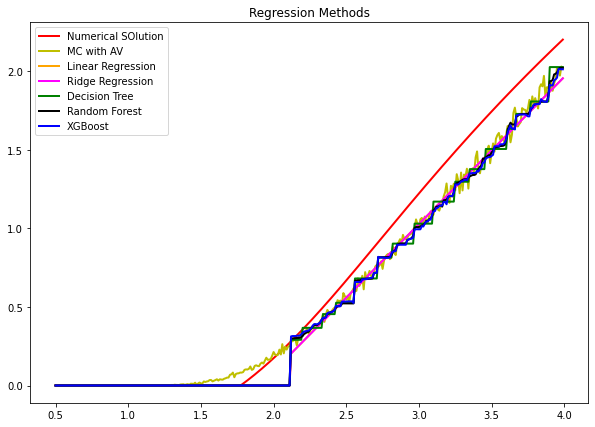

In [6]:
plt.figure(figsize=(10,7))
#sns.scatterplot(data=df1, x="stock_zero", y="price", alpha =0.3)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='Numerical SOlution')
plt.plot(S0, df1_mc.mc_price_av, color='y', linewidth=2, label='MC with AV')
plt.plot(S0, df1_regre.linear_best_s0, color='orange', linewidth=2, label='Linear Regression')
plt.plot(S0, df1_regre.ridge_best_s0, color='magenta', linewidth=2, label='Ridge Regression')
plt.plot(S0, df1_regre.dec_tree_s0, color='green', linewidth=2, label='Decision Tree')
plt.plot(S0, df1_regre.RFR_best_s0, color='black', linewidth=2, label='Random Forest')
plt.plot(S0, df1_regre.xgb_regress_s0, color='blue', linewidth=2, label='XGBoost')
plt.title("Regression Methods")
plt.legend()
plt.savefig('plots/regression_models.pdf')
plt.show()

## ATM area  <a class="anchor" id="atm"></a>

First we check where is the classification threshold, than we inlude the area around it in the regression.

In [36]:
df1_ordered = df1.sort_values(by=['stock_zero']).reset_index(drop=True)
df1_ordered.head()

,stock_zero,price,pred_executed_logistic
0,0.387751,0.0,False
1,0.407598,0.0,False
2,0.419984,0.0,False
3,0.422262,0.0,False
4,0.426654,0.0,False


In [37]:
S0_class = logreg.predict(S0.reshape(-1, 1))
X_class = df1_ordered['pred_executed_logistic']

In [38]:
# X:
X_len = len(X_class)
area_size_step = int(X_len/20) # 5% of the total S0 range
area_size_step

3500

In [39]:
# identify step position
where_changes = [i for i in range(1,X_len) if X_class[i]!=X_class[i-1] ]
step_position = int(np.mean(where_changes))
step_position

32525

In [40]:
# where begin regression
begin_regression_pos = step_position - area_size_step
begin_regression_pos

29025

In [41]:
df1_regr_with_area = df1_ordered.loc[begin_regression_pos:]
df1_regr_with_area.head()

,stock_zero,price,pred_executed_logistic
29025,1.944814,0.000000,False
29026,1.944823,0.000000,False
29027,1.944867,0.000000,False
29028,1.944921,0.385596,False
29029,1.945016,0.000000,False


**Linear regression including the ATM area:**

In [42]:
X_area = df1_regr_with_area['stock_zero']
y_area = df1_regr_with_area['price']

X_train_area, X_test_area, y_train_area, y_test_area = train_test_split(X_area, y_area, test_size=0.20)

In [43]:
X_train_area = X_train_area.values.reshape(-1, 1)
y_train_area = y_train_area.values.reshape(-1, 1)
X_test_area = X_test_area.values.reshape(-1, 1)

In [44]:
lin_area = LinearRegression()
lin_area.fit(X_train_area, y_train_area)
y_pred_lin_area = lin_area.predict(X_test_area)

In [45]:
# S0:
S0_len = len(S0)
area_size_step_S0 = int(S0_len/10)

In [46]:
where_changes_S0 = [i for i in range(1,len(S0)) if S0_class[i]!=S0_class[i-1] ]
step_position_S0 = int(np.mean(where_changes_S0))
step_position_S0

162

In [47]:
# where begin regression
begin_regression_pos_S0 = step_position_S0 - area_size_step_S0
begin_regression_pos_S0

127

In [48]:
lin_s0_area_regr = lin_area.predict(S0[begin_regression_pos_S0:].reshape(-1, 1))
lin_s0_area_regr = [x if x>0 else 0 for x in lin_s0_area_regr] 
lin_s0_with_area = np.concatenate((np.zeros(begin_regression_pos_S0), lin_s0_area_regr))

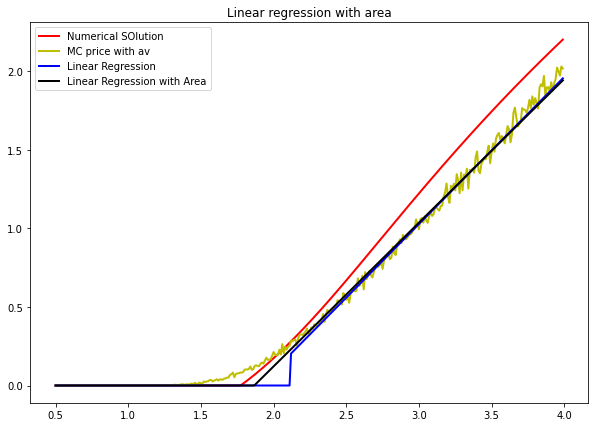

In [73]:
plt.figure(figsize=(10,7))
#sns.scatterplot(data=df1, x="stock_zero", y="price", alpha =0.3)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='Numerical SOlution')
plt.plot(S0, df1_mc. mc_price_av, color='y', linewidth=2, label='MC price with av')
plt.plot(S0, df1_regre.linear_best_s0, color='blue', linewidth=2, label='Linear Regression')
plt.plot(S0, lin_s0_with_area, color='black', linewidth=2, label='Linear Regression with Area')
plt.title("Linear regression with area")
plt.legend()
plt.savefig('plots/linear_with_area.pdf')
plt.show()

In [69]:
print("Numerical solution: \n")
print("  Linear RMSE without area:", np.sqrt(mean_squared_error(df1_mc.num_price, df1_regre.linear_best_s0)))
print("  Linear RMSE with area:", np.sqrt(mean_squared_error(df1_mc.num_price, lin_s0_with_area)))
print("\nMonte Carlo: \n")
print("  Linear RMSE without area:", np.sqrt(mean_squared_error(df1_mc. mc_price_av, df1_regre.linear_best_s0)))
print("  Linear RMSE with area:", np.sqrt(mean_squared_error(df1_mc. mc_price_av, lin_s0_with_area)))

Numerical solution: 

  Linear RMSE without area: 0.15119602024427806
  Linear RMSE with area: 0.14213526207369503

Monte Carlo: 

  Linear RMSE without area: 0.0630167939775045
  Linear RMSE with area: 0.0434779198188384


**XGBoost with area**

In [ ]:
params = {
    'n_estimators': [100, 200, 300],
    'max_depth': [2, 3, 6],
    'learning_rate': [0.01, 0.02],
    'subsample': [0.6, 0.8],
    'objective' :['reg:squarederror']
    
}
tree_area = GridSearchCV(XGBRegressor(silent=False,random_state=10), params, scoring ='neg_mean_squared_error')

tree_area.fit(X_train_area, y_train_area)

In [60]:
tree_area_regr = tree_area.predict(S0[begin_regression_pos_S0:].reshape(-1, 1))
tree_area_regr = [x if x>0 else 0 for x in tree_area_regr] 
tree_with_area = np.concatenate((np.zeros(begin_regression_pos_S0), tree_area_regr))

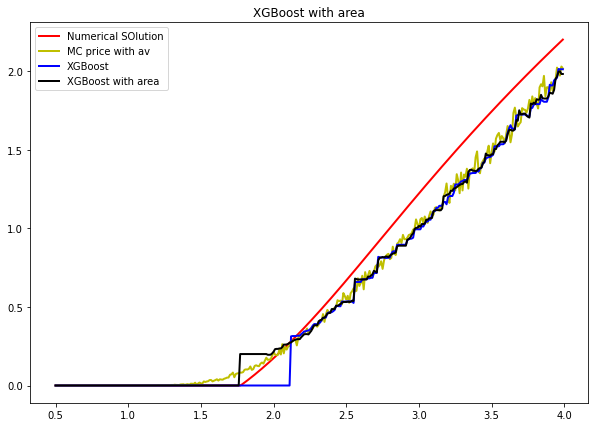

In [71]:
plt.figure(figsize=(10,7))
#sns.scatterplot(data=df1, x="stock_zero", y="price", alpha =0.3)
plt.plot(S0, df1_mc.num_price, color='r', linewidth=2, label='Numerical SOlution')
plt.plot(S0, df1_mc. mc_price_av, color='y', linewidth=2, label='MC price with av')
plt.plot(S0, df1_regre.xgb_regress_s0, color='blue', linewidth=2, label='XGBoost')
plt.plot(S0, tree_with_area, color='black', linewidth=2, label='XGBoost with area')
plt.title("XGBoost with area")
plt.legend()
plt.savefig('plots/decision_with_area.pdf')
plt.show()

In [72]:
print("Numerical solution: \n")
print("  XGBoost RMSE without area:", np.sqrt(mean_squared_error(df1_mc.num_price,df1_regre.xgb_regress_s0)))
print("  XGBoost RMSE with area:", np.sqrt(mean_squared_error(df1_mc.num_price, tree_with_area)))
print("\nMonte Carlo: \n")
print("  XGBoost RMSE without area:", np.sqrt(mean_squared_error(df1_mc. mc_price_av, df1_regre.xgb_regress_s0)))
print("  XGBoost RMSE with area:", np.sqrt(mean_squared_error(df1_mc. mc_price_av, tree_with_area)))

Numerical solution: 

  XGBoost RMSE without area: 0.1565113853649121
  XGBoost RMSE with area: 0.1512635292718006

Monte Carlo: 

  XGBoost RMSE without area: 0.06450042029852468
  XGBoost RMSE with area: 0.04012366235396293


## Add other features  <a class="anchor" id="other_variables"></a>
We create a new dataset adding many features. Then we run Logistic Regression and Linear Regression

In [6]:
# model parameters
Sigma = [0.4, 0.8]
Theta = [0.01, 0.05]
Kappa = [5, 6]
Rho = [-0.5, -0.7]
T1 = 10
S0 = np.arange(0.5,4,0.1)
V0 = [0.01, 0.1]

In [7]:
# option parameters
int_rates = [0, 0.05]
k = 2
time_maturity = [1, 3]

In [8]:
num_simulations = 100
n = 100

Stock prices simulation:

In [11]:
df2 = pd.DataFrame(columns=['price', 'stock_zero',
                           'sigma',  
                           'maturity', 'initial_vol', 
                           'kappa', 'rho',
                           'theta','interest_rates'])

In [12]:
# fill the dataset
for v0 in V0:
    print(f"\nvo {v0}")
    for sigma in Sigma:
        print(f"sigma {sigma}")
        for theta in Theta:
            print(f"theta {theta}")
            for kappa in Kappa:
                print(f"kappa {kappa}")
                for rho in Rho:
                    print(f"rho {rho}")
                    for s0 in S0:
                        for t in time_maturity:
                            for r in int_rates:
                                s = stock_price_generator (t, n, num_simulations, r, s0, k, v0, sigma, theta, kappa, rho, generator, entire_stock=True)

                                for stock_path in s: # for each simulation
                                    price = find_expected_payoff(stock_path, k, r, t)
                                    
                                    new_row = {
                                        'price':price, 
                                        'stock_zero':stock_path[T1],
                                        'maturity':t, 
                                        'sigma':sigma,
                                        'theta':theta,
                                        'kappa': kappa,
                                        'rho': rho,
                                        'initial_vol': v0, 
                                        'interest_rates':r
                                    }
                                    #append row to the dataframe
                                    df2 = df2.append(new_row, ignore_index=True)



vo 0.01
sigma 0.4
theta 0.01
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7
theta 0.05
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7
sigma 0.8
theta 0.01
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7
theta 0.05
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7

vo 0.1
sigma 0.4
theta 0.01
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7
theta 0.05
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7
sigma 0.8
theta 0.01
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7
theta 0.05
kappa 5
rho -0.5
rho -0.7
kappa 6
rho -0.5
rho -0.7


In [31]:
df2.head()

,stock_zero,sigma,maturity,initial_vol,kappa,rho,theta,exercise
0,0.515862,0.4,1.0,0.01,5.0,-0.5,0.01,False
1,0.506035,0.4,1.0,0.01,5.0,-0.5,0.01,False
2,0.480199,0.4,1.0,0.01,5.0,-0.5,0.01,False
3,0.503627,0.4,1.0,0.01,5.0,-0.5,0.01,False
4,0.525715,0.4,1.0,0.01,5.0,-0.5,0.01,False


In [32]:
#df2.to_csv('df2.csv')

## Classification

In [17]:
df2['exercise'] = df2.price!=0
df2 = df2.drop(['price', 'interest_rates'], axis=1)
df2.head()

,stock_zero,sigma,strike,maturity,initial_vol,kappa,rho,theta,exercise
0,0.515862,0.4,NaN,1.0,0.01,5.0,-0.5,0.01,False
1,0.506035,0.4,NaN,1.0,0.01,5.0,-0.5,0.01,False
2,0.480199,0.4,NaN,1.0,0.01,5.0,-0.5,0.01,False
3,0.503627,0.4,NaN,1.0,0.01,5.0,-0.5,0.01,False
4,0.525715,0.4,NaN,1.0,0.01,5.0,-0.5,0.01,False


In [19]:
df2.groupby('exercise').count().stock_zero

exercise
False    202515
True     245485
Name: stock_zero, dtype: int64

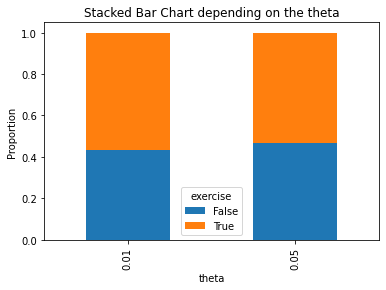

In [21]:
table = pd.crosstab(df2.theta, df2.exercise)
table.div(table.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
plt.title('Stacked Bar Chart depending on the theta')
plt.xlabel('theta')
plt.ylabel('Proportion');

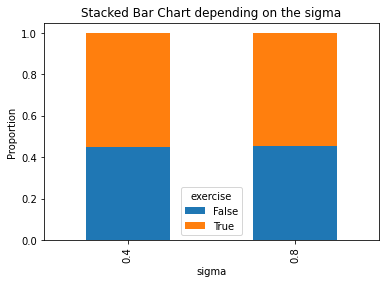

In [23]:
table = pd.crosstab(df2.sigma, df2.exercise)
table.div(table.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
plt.title('Stacked Bar Chart depending on the sigma')
plt.xlabel('sigma')
plt.ylabel('Proportion');

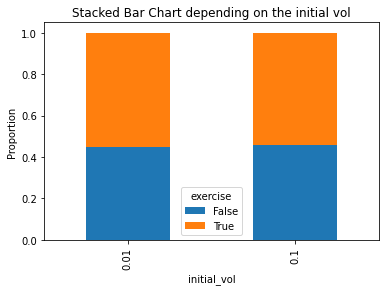

In [24]:
table = pd.crosstab(df2.initial_vol, df2.exercise)
table.div(table.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
plt.title('Stacked Bar Chart depending on the initial vol')
plt.xlabel('initial_vol')
plt.ylabel('Proportion');

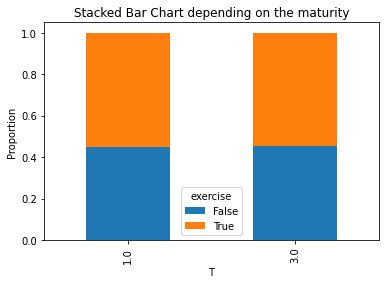

In [26]:
table = pd.crosstab(df2.maturity, df2.exercise)
table.div(table.sum(1).astype(float), axis=0).plot(kind='bar', stacked=True)
plt.title('Stacked Bar Chart depending on the maturity')
plt.xlabel('T')
plt.ylabel('Proportion')
plt.savefig('e_vs_ne_strike')

#### Logistic Regression

In [37]:
X = df2.drop('exercise', axis = 1)
y = df2['exercise']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

In [34]:
X_train = X_train.values.reshape(-1, 1)
X_test = X_test.values.reshape(-1, 1)
y_train = y_train.values.reshape(-1, 1)
y_test = y_test.values.reshape(-1, 1)

In [38]:
logreg2 = LogisticRegression()
logreg2.fit(X_train, y_train)

LogisticRegression()

In [42]:
X.columns

Index(['stock_zero', 'sigma', 'maturity', 'initial_vol', 'kappa', 'rho',
       'theta'],
      dtype='object')

In [49]:
weights = logreg2.coef_
abs_weights = np.abs(weights).flatten()

print(f"Print Feature importance: \n")
for i in range(len(X.columns)):
    print(f"{X.columns[i]}: {abs_weights[i]}")

Print Feature importance: 

stock_zero: 3.3723396053896884
sigma: 0.06440089290982819
maturity: 0.009522686583890211
initial_vol: 0.3605304077959656
kappa: 0.015389850642859334
rho: 0.06372447910342552
theta: 0.05335492


## S0 fixed and K moves  <a class="anchor" id="k"></a>

In [16]:
# set parameters and constants
r = 0
K = np.arange(0.5,4,0.05)
V0 = 0.01
sigma = 0.6
theta = 0.02
kappa = 6.21
rho = -0.5

s0 = 2

In [17]:
time_maturity = 3
num_simulations = 100
n = 250 # numbers of division of the time 

In [18]:
df3 = pd.DataFrame(columns=['k', 'price'])
num_price = []

In [19]:
# fill the dataset
for k in K:
    s = stock_price_generator (time_maturity, n, num_simulations, r, s0, k, V0, sigma, theta, kappa, rho, generator, entire_stock=True)

    for stock_path in s: # for each simulation
        price = find_expected_payoff(stock_path, k, r, time_maturity)
        num_price.append(call_price(kappa, theta, sigma, rho, V0, r, time_maturity, s0, k))
        
        new_row = {
                      'price':price, 
                      'k':k,
                  }
        #append row to the dataframe
        df3 = df3.append(new_row, ignore_index=True)

In [35]:
df3_class = pd.DataFrame()
df3_class['exercise'] = df3.price!=0
df3_class['k'] = df3.k
df3_class['price'] = df3.price
df3_class.head()

,exercise,k,price
0,True,0.5,1.297998
1,True,0.5,1.637903
2,True,0.5,1.893333
3,True,0.5,0.663243
4,True,0.5,1.571816


In [36]:
X_class = df3_class['k']
y_class = df3_class['exercise']

x_train_class, x_test_class, y_train_class, y_test_class = train_test_split(X_class, y_class, test_size=0.2)

In [37]:
x_train_class = x_train_class.values.reshape(-1, 1)
y_train_class = y_train_class.values.reshape(-1, 1)
x_test_class = x_test_class.values.reshape(-1, 1)

In [38]:
logreg3 = LogisticRegression()
logreg3.fit(x_train_class, y_train_class)

LogisticRegression()

In [39]:
df3_class['exercise_predict'] = logreg3.predict(df3_class['k'].values.reshape(-1, 1))

In [40]:
df3_class_linear = df3_class.loc[ df3_class['exercise_predict']==True ]
df3_class_linear.head()

,exercise,k,price,exercise_predict
0,True,0.5,1.297998,True
1,True,0.5,1.637903,True
2,True,0.5,1.893333,True
3,True,0.5,0.663243,True
4,True,0.5,1.571816,True


In [41]:
y = df3_class_linear.price
X = df3_class_linear.k

x_train_lin_cleaned, x_test_lin_cleaned, y_train_lin_cleaned, y_test_lin_cleaned = train_test_split(X, y, test_size=0.2)

In [42]:
x_train_lin_cleaned = x_train_lin_cleaned.values.reshape(-1, 1)
y_train_lin_cleaned = y_train_lin_cleaned.values.reshape(-1, 1)
x_test_lin_cleaned = x_test_lin_cleaned.values.reshape(-1, 1)

In [43]:
lin_clean3 = LinearRegression()
lin_clean3.fit(x_train_lin_cleaned, y_train_lin_cleaned)

LinearRegression()

In [44]:
price_pred_lin_cleaned3 = lin_clean3.predict(K.reshape(-1, 1))

In [46]:
price_log_lin_cleaned3 = []

for i in range(len(K)):
    if execute_log3[i]==0:
        price_log_lin_cleaned3.append(0)
    else:
        price_log_lin_cleaned3.append(price_pred_lin_cleaned3[i])    

In [52]:
num_price = []

for k in K:
    num_price.append(call_price(kappa, theta, sigma, rho, V0, r, time_maturity, s0, k))

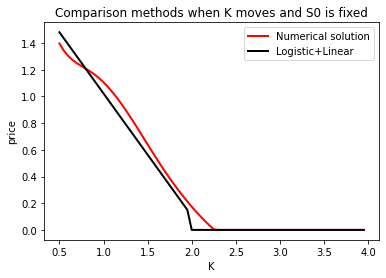

In [54]:
plt.plot(K, num_price, color='red', linewidth=2, label='Numerical solution')
plt.plot(K, price_log_lin_cleaned3, color='black', linewidth=2, label='Logistic+Linear') 
plt.legend()
plt.title("Comparison methods when K moves and S0 is fixed")
plt.xlabel("K")
plt.ylabel("price")
plt.show()

This plot is exactly the reflection of the plot when K is fixed and S0 moves. Ths makes sense because when K decreases, if S0 is fixed, the option is more ITM and its price must increase. ON the other hand, if K is too high, the option will not be exercised with an high probability, so the priced goes down and reach zero for suffiently high values of K. The ATM is always the name, because it depends on S0/K.
